# Install KeplerGL

*The following installation should properly work with Jupyter Notebook. To use Jupyter Lab extension or if having any problems related to installation please refer to the full installation guide: https://docs.kepler.gl/docs/keplergl-jupyter#install*

1) Use pip to install KeplerGL in your environment first:

**$ pip install keplergl**

2) Install and enable jupyter extension (can be skipped for Mac + notebook 5.3 and above):

**$ jupyter nbextension install --py --sys-prefix keplergl**

**$ jupyter nbextension enable --py --sys-prefix keplergl**


3) Tell Jupyter to trust the notebook. More on trusting notebooks can be found here: https://jupyter-notebook.readthedocs.io/en/latest/notebook.html?highlight=trust#trusting-notebooks  

**$ jupyter trust VIZ_KeplerGL_Test.ipynb**

# Create a map and add data with Kepler.gl

**Note: for better performance use Jupyter Notebook, not Jupyter Lab.**

In [1]:
from keplergl import KeplerGl

The following command will load kepler.gl widget below the cell with a map object.

In [2]:
# Load an empty map
hel_map = KeplerGl(height=600)   # optional input: (heigth, data, config)
hel_map

User Guide: https://github.com/keplergl/kepler.gl/blob/master/docs/keplergl-jupyter/user-guide.md


KeplerGl(height=600)

The loaded map overlooks *San Francisco, California* by default. To move the map view to a location of interest, load the traffic simulation output file, and/or road network data that you want to visualize. Note that kepler.gl supports only CSV, GeoJSON, Pandas DataFrame or GeoPandas GeoDataFrame. Read more about formats here: https://docs.kepler.gl/docs/keplergl-jupyter#3-data-format

**All layers should have a common projection WGS 84 / Pseudo-Mercator to load properly.**

*Make sure to provide correct file paths to your simulation version's output folder.*

In [3]:
# Load GeoJSON file with a road network if needed
with open('OSM_Hel_bus_routes.geojson', 'r') as f:
    geojson = f.read()
    
# Add data to the map
# add_data requires CSV, GeoJSON or DataFrame
hel_map.add_data(data=geojson, name='routes')

In [4]:
# Load GeoJSON with a traffic simulation output
with open('simulation_4_output.geojson', 'r') as f:
    new = f.read()
    
# Add data to the map
# add_data requires CSV, GeoJSON or DataFrame
hel_map.add_data(data=new, name='traffic')

In [5]:
# Load any other additional dataset (uncomment and change "other" to a name of your dataset)
# with open('other.geojson', 'r') as f:
    # other = f.read()
    
# Add data to the map
# add_data requires CSV, GeoJSON or DataFrame
#hel_map.add_data(data=other, name='other')

If you need to save the current map data to load the map back afterwards, you can save it using the following command:

In [6]:
# Print the current data as a dict (uncomment the line below if needed)
#hel_map.data

# Interact with widget and customize layers and filters 


When layers are added to the map, you can press the gray **arrow in the upper left corner** and open the menu to interact with the widget. By default, only the first added layer is visualized automatically. 

To **visualize another layer**, you need to press the *Add layer button -> new layer's arrow down  -> Basic -> **!FIRST!** Data source (choose a layer) -> Select a type (type of layer: 'Polygon' for lines and line strings) -> Stroke color -> Stroke width*. Other widget functions can be added (e.g. range filters), color schemes can be changed, the map additionally configured, interaction customized, etc. More customization instructions can be found in the user guide: https://docs.kepler.gl/docs/user-guides/g-interactions

To be able to filter the data by time, add a **filter based on a timestamps** field of a traffic simulation layer (*Filters* menu on the right from *Layers* menu of the widget). Choose a field (timestamps) for the filter and move the filter constrains to filter time segments to display. 

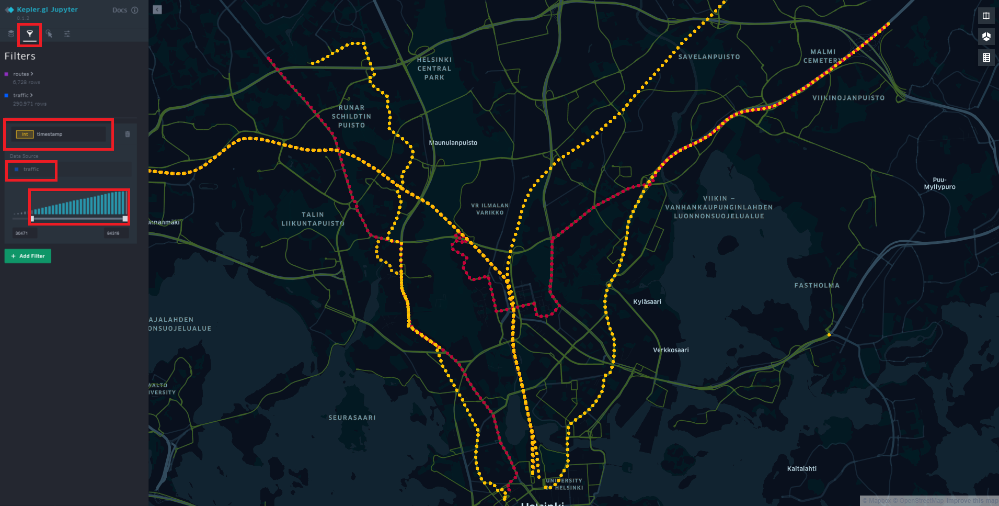


*In example traffic output visualization darker colors represent earlier movements, and brighter colors (yellow) — later movements. To choose a field on which the color is based press menu icon for Fill color in Layer window. In the example, the color is based on the timestemps field.*

Map data and config will be stored locally to the widget state.  To make sure the map state is saved, select Widgets > Save Notebook Widget State, before shutting down the kernel. When the map is final, you can copy this config and load it later to reproduce the same map. 

In [7]:
# Print map configuration (uncomment the line below if needed)
#hel_map.config

In [8]:
# Save hel_map config to a file
with open('hel_config.py', 'w') as f:
    f.write('config = {}'.format(hel_map.config))
    
# Load the config (uncomment the line below if needed)
#%run hel_config.py

# Export the map as an interactive html file

In [9]:
# This will save the current map with data and config
hel_map.save_to_html(data=hel_map.data, config=hel_map.config, file_name='hel_test.html')

Map saved to hel_test.html!


In [10]:
# This will save map with the interaction panel disabled (uncomment the line below if needed)
#hel_map.save_to_html(file_name='hel_test_readonly.html' read_only=True)

**Note: the files used in the example visualization are provided in the same folder with the notebook. When inputting new simulation results provide new file paths to the new simulation output and/or any additional datasets.**

# Dynamic visualization with kepler

To enable animation of agents and their paths, the geoJSON data needs to contain `LineString` in its feature geometry, and the coordinates in the LineString need to have 4 elements in the formats of [longitude, latitude, altitude, timestamp] with the last element being a timestamp. 

*Example:*
`"geometry": {
                      "type": "LineString",
                      "coordinates": [
                        [-74.20986, 40.81773, 0, 1564184363],
                        [-74.20987, 40.81765, 0, 1564184396],
                        [-74.20998, 40.81746, 0, 1564184409]
                      ]
                     }`

After loading a GeoJSON with 4D coordinates to the widget, and creating a new visualization layer for the file, a type of layer named ‘Trip’ should be chosen. The timestamped coordinates then will prompt a time playback window to appear on the bottom of the map with the bars representing distribution graphs of all data points by time. It then can play/pause the time series to see agents’ movements.

*Example: (data and map config: kepler.gl)* 

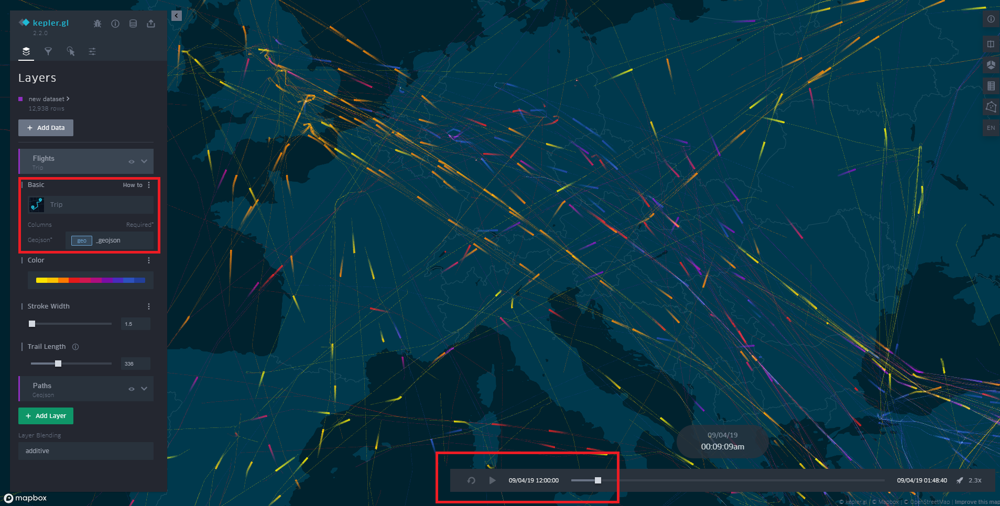

Once the map is configured, it can be shared as an interactive html using similar code as above.